In [4]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# IMAGE ANALYSIS FRAMEWORK FOR GIST DATA

*describe the sample and microscopy technique

In [5]:
#Import libraries needed
import numpy as np #library for dealing with arrays (image=array)
import pandas as pd #library for dealing with databases
from matplotlib import pyplot as plt #plotting library
import random

# Loading our images:
This stage has to be very organized and well annotated to make it easy to reach for the images we want whenever we want.

Since they are all named the same with exception of the last digit (A-N), we will load them smartly with a loop and store them in a dictionary.

In [3]:
from skimage import io # skimage = library for image analysis // io = function for loading images.

#LLRO
letter_LLRO = ('A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O')
img_LLRO = {}
for i in letter_LLRO:
    img_LLRO["{0}".format(i)] = io.imread('./raw-images/LLRO/20210621-GIST-TMA-SBR-LLR0-A01-'+ i + '.tif')
print(img_LLRO.keys())

#LRRO
letter_LRRO = ('A', 'G', 'J', 'K', 'L', 'M')
img_LRRO = {}
for i in letter_LRRO:
    img_LRRO["{0}".format(i)] = io.imread('./raw-images/LRRO/20210621-GIST-TMA-SBR-LRR0-A01-'+ i + '.tif')
print(img_LRRO.keys())

#ULRO
letter_ULRO = ('A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N')
img_ULRO = {}
for i in letter_ULRO:
    img_ULRO["{0}".format(i)] = io.imread('./raw-images/ULRO/20210621-GIST-TMA-SBR-ULR0-A01-'+ i + '.tif')
print(img_ULRO.keys())

#URRO
letter_URRO = ('A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N')
img_URRO = {}
for i in letter_URRO:
    img_URRO["{0}".format(i)] = io.imread('./raw-images/URRO/20210621-GIST-TMA-SBR-URR0-A01-'+ i + '.tif')
print(img_URRO.keys())

dict_keys(['A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O'])
dict_keys(['A', 'G', 'J', 'K', 'L', 'M'])
dict_keys(['A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N'])
dict_keys(['A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N'])


In [4]:
tot=len(letter_LLRO)+len(letter_LRRO)+len(letter_ULRO)+len(letter_URRO)
print('number of samples/images that we have is: {0}' .format(tot))

number of samples/images that we have is: 38


Lets create a variable that stores info about to which patient each image corresponds to

In [7]:
G_LLRO = np.array(['G9', 'G9', 'G10', 'G6','G6', 'G7', 'G4', 'G1', 'G1', 'G2'])
G_LRRO = np.array(['G10', 'G7', 'G4', 'G5','G5', 'G2'])
G_ULRO = np.array(['G20', 'G20', 'G21', 'G19','G16', 'G16', 'G17', 'G14', 'G14', 'G15', 'G11', 'G11'])
G_URRO = np.array(['G21', 'G20', 'G21', 'G19','G17', 'G17', 'G18', 'G15', 'G13', 'G13'])

check the images shape:

In [5]:
print(np.shape(img_LLRO)) #dictionary
print(np.shape(img_LLRO['A'])) #hipermatrix of 12 channels

()
(12, 1280, 1280)


we want our images to have the shape (x row pixels, y column pixels, c channels).

In [6]:
dict_list = [img_LLRO, img_LRRO, img_ULRO, img_URRO]
for d in dict_list: 
    for im in d: #loop across every object (image) in the dictionary.
            #Check if the images are the right shape: we want to have (rows, columns, channels)  
            rows = d[im].shape[0] #number of rows
            cols = d[im].shape[1] #number of columns
            if rows < 100:
                d[im] = np.moveaxis(d[im], 0, 2) #reestructuring of image matrix

            elif cols < 100:
                d[im] = np.moveaxis(d[im], 1, 2) #reestructuring of image matrix
            ch = d[im].shape[2] #number of channels

check the images shape:

In [7]:
print(np.shape(img_LLRO['A'])) #hipermatrix of 12 channels

(1280, 1280, 12)


# Inspecting our images:
We have 38 images of 19 (GIST 1-21 except 8 and 3) different patients each of them with 12 different channels.
We have stored them in 4 different dictionaries depending on where was the sample located: UpperLeftRO, UpperRightRO, LowerLeftRO, LowerRightRO.

Channels:
- CH0  --> dapi (405nm)
- CH1  --> N/A (647nm)
- CH2  --> N/A (565nm)
- CH3  --> dapi (405nm)
- CH4  --> pRb1 (647nm)
- CH5  --> Rb1 (565nm)
- CH6  --> dapi (405nm)
- CH7  --> Cyclin (647nm)
- CH8  --> p16 (565nm)
- CH9  --> dapi (405nm)
- CH10 --> N/A (645nm)
- CH11 --> p53 (565nm)

We have built a function called 'img_inspection' wich will allow us to randomply study 3 of our 14 samples and for every one of them, plot its DAPI channel, its control image and a random marker channel.  In addition to this, for each of these selected samples, we will see a dataframe (table) with info like number of rows, column, sample name, channel number plotted, wavelenght at which the image was taken and brightest and darkest value in the image.

For more info about this function, check out the documentation.

          ch_index  max_value  min_value          mean  median
Dapi             0      54972       1139  10700.762428  8557.0
Control          2       8645        403   1436.704213  1424.0
Sample M         8      16687        688   3507.276389  3414.0
images' size: (rows=1280, columns=1280,number of channels=12)  /  wavelength plotted channel=565nm


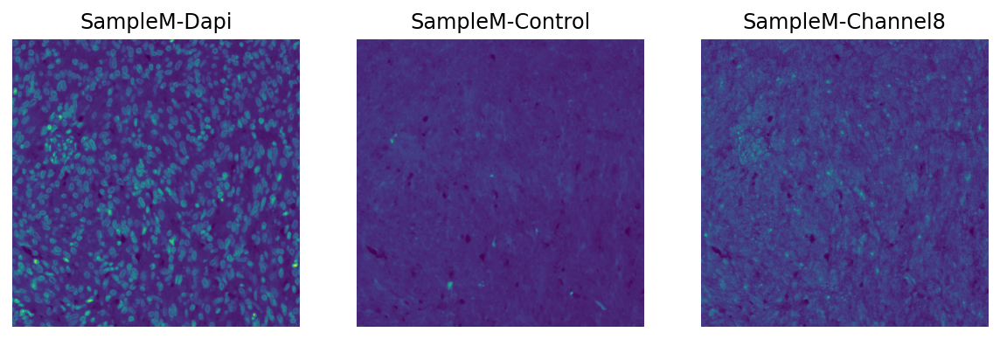

In [8]:
from preprocessing_GIST import img_inspection #we import our previously built function

#IMAGE OPTIONS: random or:
#          LLRO: ('A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O')
#          LRRO: ('A', 'G', 'J', 'K', 'L', 'M')
#          ULRO: ('A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N')
#          URRO: ('A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N')

#CHANNEL OPTIONS: 4,5,7,8,11 or random

#IMAGE DICTIONARY OPTIONS: img_LLRO, img_LRRO, img_ULRO, img_URRO
#see function's documentation for more info.

img_inspection(img_LLRO, r=1, image=('M'), channel=8, view=True, table_summary=True, histogram=False)

Lets also quickly examine all the channels of, for example, sample G:

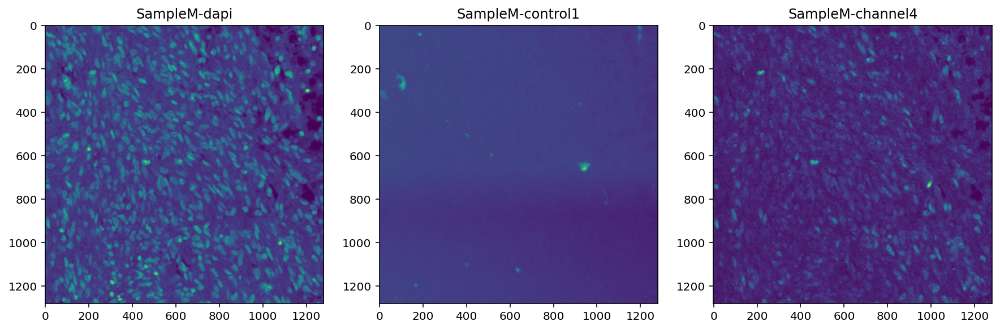

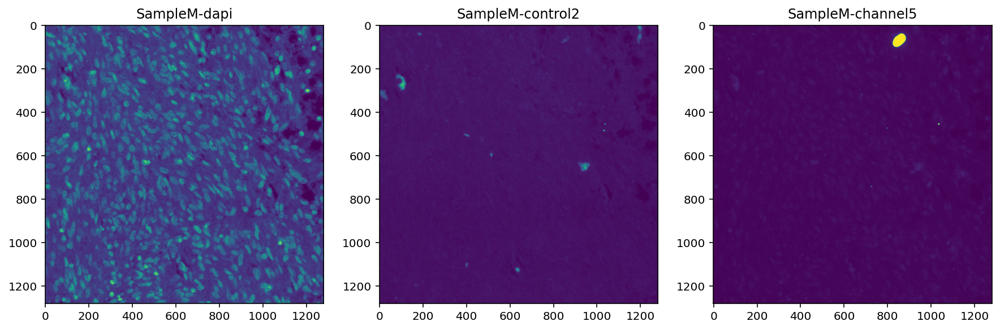

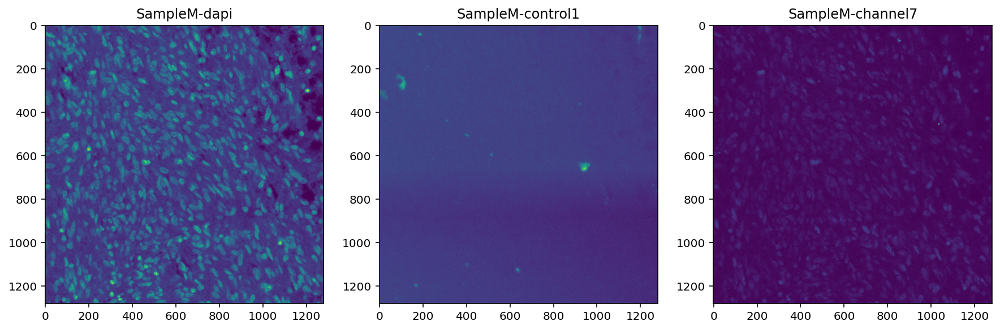

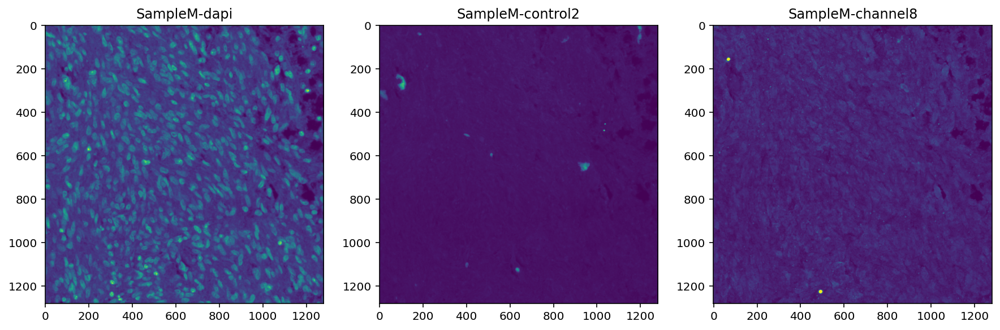

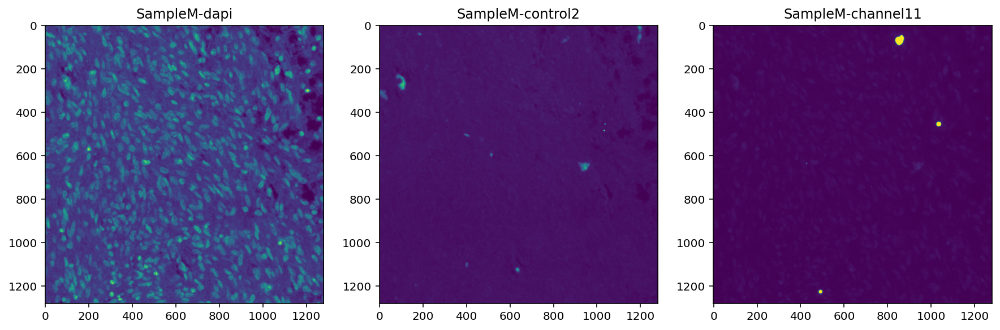

In [12]:
img_dict = img_LRRO #img_LLRO, img_LRRO, img_ULRO, img_URRO

patient='M'
#patient OPTIONS:
#          LLRO: ('A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O')  !!Hch11, Ich8&11, Lch5&11, Och5&11
#          LRRO: ('A', 'G', 'J', 'K', 'L', 'M') !!Jch11, Kch5, Lch7, Mch5&8&11
#          ULRO: ('A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N') !!Fch11, Hch5
#          URRO: ('A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N') !!Dchctr2&5&8&11, Gchctr2&5&8&11, Hch8&11, Ich5, Nch11

channels=np.array([4,5,7,8,11])

for i in channels:
    if (i - 1) % 3 == 0:
        n_ctrl = 1
    else:
        n_ctrl = 2
        
    fig, ax = plt.subplots(1, 3, figsize=(15,15)) #we create a figure with two subplots (1row, 2columns)
    ax[0].imshow(img_dict[patient][:,:,0]) #what we plot in the subplot1
    ax[0].set_title('Sample{0}-dapi'.format(patient)) #subplot title
    ax[1].imshow(img_dict[patient][:,:,n_ctrl]) #what we plot in the subplot1
    ax[1].set_title('Sample{0}-control{1}'.format(patient, n_ctrl)) #subplot title
    ax[2].imshow(img_dict[patient][:,:,i])  #what we plot in the subplot2
    ax[2].set_title('Sample{0}-channel{1}'.format(patient, i)) #subplot title

After this initial study we have observed that there are some extreme values that are very likely to be due to dust. We definetelly want to remove those and we'll do it through the technique called **clipping**.

The images with this really extreme values are:
* LLRO, images H (channel 11),  I (channels 8 and 11), L (channels 5 and 11) and O (channels 5 and 11).

* LRRO: images J (channel 11), K (channel 5), L (channel 7), M (channels 5, 8 and 11)

* ULRO: images F (channel 11) and H (channel 5).

* URRO: images D (channels ctr 2, 5, 8 and 11), G (channels ctr 2, 5, 8 and 11), H (channels 8 and 11), I (channel 5), N (channel 11).



We will segment these points and color them with the median value of our image, in other words, we will consider them as background.

In [87]:
import copy
extremeless_LLRO = copy.deepcopy(img_LLRO)
extremeless_LRRO = copy.deepcopy(img_LRRO)
extremeless_ULRO = copy.deepcopy(img_ULRO)
extremeless_URRO = copy.deepcopy(img_URRO)

from skimage.morphology import dilation, square, disk
from skimage.filters import gaussian

th_LLRO_H11 = np.percentile(extremeless_LLRO['H'][:,:,11],99.97)
th_LLRO_I8 = np.percentile(extremeless_LLRO['I'][:,:,8],99.88)
th_LLRO_I11 = np.percentile(extremeless_LLRO['I'][:,:,11],99.89) 
th_LLRO_L5 = np.percentile(extremeless_LLRO['L'][:,:,5],99.99) 
th_LLRO_L11 = np.percentile(extremeless_LLRO['L'][:,:,11],99.99) 
th_LLRO_O5 = np.percentile(extremeless_LLRO['O'][:,:,5],99.99) 
th_LLRO_O11 = np.percentile(extremeless_LLRO['O'][:,:,11],99.99) 

th_LRRO_J11 = np.percentile(extremeless_LRRO['J'][:,:,11],99.99) 
th_LRRO_K5 = np.percentile(extremeless_LRRO['K'][:,:,5],99.99) 
th_LRRO_J5 = np.percentile(extremeless_LRRO['J'][:,:,5],99.99) 
th_LRRO_L7 = np.percentile(extremeless_LRRO['L'][:,:,7],99.97) 
th_LRRO_M5 = np.percentile(extremeless_LRRO['M'][:,:,5],99.99) 
th_LRRO_M8 = np.percentile(extremeless_LRRO['M'][:,:,8],99.99) 
th_LRRO_M11 = np.percentile(extremeless_LRRO['M'][:,:,11],99.99) 

th_ULRO_F11 = np.percentile(extremeless_ULRO['F'][:,:,11],99.97) 
th_ULRO_H5 = np.percentile(extremeless_ULRO['H'][:,:,5],99.97) 

th_URRO_D2 = np.percentile(extremeless_URRO['D'][:,:,2],99.91) 
th_URRO_D5 = np.percentile(extremeless_URRO['D'][:,:,5],99.95) 
th_URRO_D8 = np.percentile(extremeless_URRO['D'][:,:,5],99.95) 
th_URRO_D11 = np.percentile(extremeless_URRO['D'][:,:,11],99.92) 
th_URRO_G2 = np.percentile(extremeless_URRO['G'][:,:,2],99.95) 
th_URRO_G5 = np.percentile(extremeless_URRO['G'][:,:,5],99.9595) 
th_URRO_G8 = np.percentile(extremeless_URRO['G'][:,:,8],99.95) 
th_URRO_G11 = np.percentile(extremeless_URRO['G'][:,:,11],99.95) 
th_URRO_H8 = np.percentile(extremeless_URRO['H'][:,:,8],99.99) 
th_URRO_H11 = np.percentile(extremeless_URRO['H'][:,:,11],99.99) 
th_URRO_I5 = np.percentile(extremeless_URRO['I'][:,:,5],99.98)
th_URRO_N11 = np.percentile(extremeless_URRO['N'][:,:,11],99.98)

#-------------------------------------------------------------------------------------------------------

mask_LLRO_H11 = dilation(extremeless_LLRO['H'][:,:,11]>=th_LLRO_H11, disk(15))
mask_LLRO_I8 = dilation(extremeless_LLRO['I'][:,:,8]>=th_LLRO_I8, disk(8))
mask_LLRO_I11 = dilation(extremeless_LLRO['I'][:,:,11]>=th_LLRO_I11, disk(15))
mask_LLRO_L5 = dilation(extremeless_LLRO['L'][:,:,5]>=th_LLRO_L5, disk(12))
mask_LLRO_L11 = dilation(extremeless_LLRO['L'][:,:,11]>=th_LLRO_L11, disk(12))
mask_LLRO_O5 = dilation(extremeless_LLRO['O'][:,:,5]>=th_LLRO_O5, disk(12))
mask_LLRO_O11 = dilation(extremeless_LLRO['O'][:,:,11]>=th_LLRO_O11, disk(12))

mask_LRRO_J11 = dilation(extremeless_LRRO['J'][:,:,11]>=th_LRRO_J11, disk(12))
mask_LRRO_K5 = dilation(extremeless_LRRO['K'][:,:,5]>=th_LRRO_K5, disk(12))
mask_LRRO_J5 = dilation(extremeless_LRRO['J'][:,:,5]>=th_LRRO_J5, disk(12))
mask_LRRO_L7 = dilation(extremeless_LRRO['L'][:,:,7]>=th_LRRO_L7, disk(12))
mask_LRRO_M5 = dilation(extremeless_LRRO['M'][:,:,5]>=th_LRRO_M5, disk(12))
mask_LRRO_M8 = dilation(extremeless_LRRO['M'][:,:,8]>=th_LRRO_M8, disk(10))
mask_LRRO_M11 = dilation(extremeless_LRRO['M'][:,:,11]>=th_LRRO_M11, disk(13))

mask_ULRO_F11 = dilation(extremeless_ULRO['F'][:,:,11]>=th_ULRO_F11, disk(13))
mask_ULRO_H5 = dilation(extremeless_ULRO['H'][:,:,5]>=th_ULRO_H5, disk(13))

mask_URRO_D2 = dilation(extremeless_URRO['D'][:,:,2]>=th_URRO_D2, disk(13))
mask_URRO_D5 = dilation(extremeless_URRO['D'][:,:,5]>=th_URRO_D5, disk(13))
mask_URRO_D8 = dilation(extremeless_URRO['D'][:,:,8]>=th_URRO_D8, disk(13))
mask_URRO_D11 = dilation(extremeless_URRO['D'][:,:,11]>=th_URRO_D11, disk(13))
mask_URRO_G2 = dilation(extremeless_URRO['G'][:,:,2]>=th_URRO_G2, disk(20)) 
mask_URRO_G5 = dilation(extremeless_URRO['G'][:,:,5]>=th_URRO_G5, disk(20)) 
mask_URRO_G8 = dilation(extremeless_URRO['G'][:,:,8]>=th_URRO_G8, disk(20))  
mask_URRO_G11 = dilation(extremeless_URRO['G'][:,:,11]>=th_URRO_G11, disk(13)) 
mask_URRO_H8 = dilation(extremeless_URRO['H'][:,:,8]>=th_URRO_H8, disk(20))  
mask_URRO_H11 = dilation(extremeless_URRO['H'][:,:,11]>=th_URRO_H11, disk(13))
mask_URRO_I5 = dilation(extremeless_URRO['I'][:,:,5]>=th_URRO_I5, disk(13))
mask_URRO_N11 = dilation(extremeless_URRO['N'][:,:,11]>=th_URRO_N11, disk(13))

#-------------------------------------------------------------------------------------------------------

dot_LLRO_H11 = np.where(mask_LLRO_H11>0)
dot_LLRO_I8 = np.where(mask_LLRO_I8>0)
dot_LLRO_I11 = np.where(mask_LLRO_I11>0)
dot_LLRO_L5 = np.where(mask_LLRO_L5>0)
dot_LLRO_L11 = np.where(mask_LLRO_L11>0)
dot_LLRO_O5 = np.where(mask_LLRO_O5>0)
dot_LLRO_O11 = np.where(mask_LLRO_O11>0)

dot_LRRO_J11 = np.where(mask_LRRO_J11>0)
dot_LRRO_K5 = np.where(mask_LRRO_K5>0)
dot_LRRO_J5 = np.where(mask_LRRO_J5>0)
dot_LRRO_L7 = np.where(mask_LRRO_L7>0)
dot_LRRO_M5 = np.where(mask_LRRO_M5>0)
dot_LRRO_M8 = np.where(mask_LRRO_M8>0)
dot_LRRO_M11 = np.where(mask_LRRO_M11>0)

dot_ULRO_F11 = np.where(mask_ULRO_F11>0)
dot_ULRO_H5 = np.where(mask_ULRO_H5>0)

dot_URRO_D2 = np.where(mask_URRO_D2>0)
dot_URRO_D5 = np.where(mask_URRO_D5>0)
dot_URRO_D8 = np.where(mask_URRO_D8>0)
dot_URRO_D11 = np.where(mask_URRO_D11>0)
dot_URRO_G2 = np.where(mask_URRO_G2>0) 
dot_URRO_G5 = np.where(mask_URRO_G5>0)
dot_URRO_G8 = np.where(mask_URRO_G8>0) 
dot_URRO_G11 = np.where(mask_URRO_G11>0)
dot_URRO_H8 = np.where(mask_URRO_H8>0) 
dot_URRO_H11 = np.where(mask_URRO_H11>0)
dot_URRO_I5 = np.where(mask_URRO_I5>0)
dot_URRO_N11 = np.where(mask_URRO_N11>0)

In [ ]:
import copy

from skimage.morphology import dilation, square, disk
from skimage.filters import gaussian

extremeless_LLRO = copy.deepcopy(img_LLRO)
extremeless_LRRO = copy.deepcopy(img_LRRO)
extremeless_ULRO = copy.deepcopy(img_ULRO)
extremeless_URRO = copy.deepcopy(img_URRO)

th = np.percentile(extremeless_LRRO['K'][:,:,5],99.999) 
mask = dilation(extremeless_LRRO['K'][:,:,5]>=th, disk(8))

Text(0.5, 1.0, 'G - Control Ch2: 565nm')

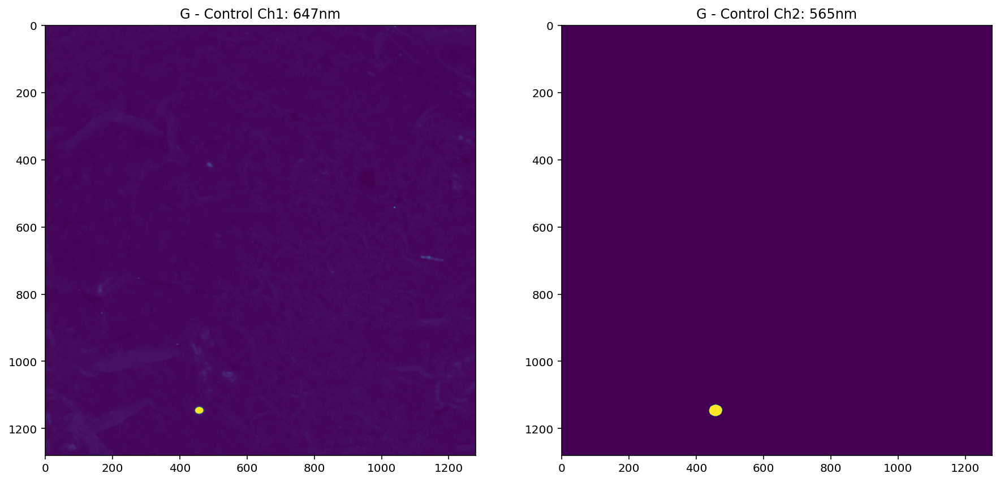

In [68]:
fig, ax = plt.subplots(1, 2, figsize=(15,15)) #we create a figure with two subplots (1row, 2columns)
ax[0].imshow(extremeless_LRRO['K'][:,:,5]) #what we plot in the subplot1
ax[0].set_title('G - Control Ch1: 647nm') #subplot title
ax[1].imshow(mask)  #what we plot in the subplot2
ax[1].set_title('G - Control Ch2: 565nm') #subplot title

In [88]:
coords_LLRO_H11 = set(zip(dot_LLRO_H11[0], dot_LLRO_H11[1]))
coords_LLRO_I8 = set(zip(dot_LLRO_I8[0], dot_LLRO_I8[1]))
coords_LLRO_I11 = set(zip(dot_LLRO_I11[0], dot_LLRO_I11[1]))
coords_LLRO_L5 = set(zip(dot_LLRO_L5[0], dot_LLRO_L5[1]))
coords_LLRO_L11 = set(zip(dot_LLRO_L11[0], dot_LLRO_L11[1]))
coords_LLRO_O5 = set(zip(dot_LLRO_O5[0], dot_LLRO_O5[1]))
coords_LLRO_O11 = set(zip(dot_LLRO_O11[0], dot_LLRO_O11[1]))

coords_LRRO_J11 = set(zip(dot_LRRO_J11[0], dot_LRRO_J11[1]))
coords_LRRO_K5 = set(zip(dot_LRRO_K5[0], dot_LRRO_K5[1]))
coords_LRRO_J5 = set(zip(dot_LRRO_J5[0], dot_LRRO_J5[1]))
coords_LRRO_L7 = set(zip(dot_LRRO_L7[0], dot_LRRO_L7[1]))
coords_LRRO_M5 = set(zip(dot_LRRO_M5[0], dot_LRRO_M5[1]))
coords_LRRO_M8 = set(zip(dot_LRRO_M8[0], dot_LRRO_M8[1]))
coords_LRRO_M11 = set(zip(dot_LRRO_M11[0], dot_LRRO_M11[1]))

coords_ULRO_F11 = set(zip(dot_ULRO_F11[0], dot_ULRO_F11[1]))
coords_ULRO_H5 = set(zip(dot_ULRO_H5[0], dot_ULRO_H5[1]))

coords_URRO_D2 = set(zip(dot_URRO_D2[0], dot_URRO_D2[1]))
coords_URRO_D5 = set(zip(dot_URRO_D5[0], dot_URRO_D5[1]))
coords_URRO_D8 = set(zip(dot_URRO_D8[0], dot_URRO_D8[1]))
coords_URRO_D11 = set(zip(dot_URRO_D11[0], dot_URRO_D11[1]))
coords_URRO_G2 = set(zip(dot_URRO_G2[0], dot_URRO_G2[1]))
coords_URRO_G5 = set(zip(dot_URRO_G5[0], dot_URRO_G5[1]))
coords_URRO_G8 = set(zip(dot_URRO_G8[0], dot_URRO_G8[1]))
coords_URRO_G11 = set(zip(dot_URRO_G11[0], dot_URRO_G11[1]))
coords_URRO_H8 = set(zip(dot_URRO_H8[0], dot_URRO_H8[1]))
coords_URRO_H11 = set(zip(dot_URRO_H11[0], dot_URRO_H11[1]))
coords_URRO_I5 = set(zip(dot_URRO_I5[0], dot_URRO_I5[1]))
coords_URRO_N11 = set(zip(dot_URRO_N11[0], dot_URRO_N11[1]))

#-------------------------------------------------------------------------------------------------------

median_LLRO_H11 = np.mean(extremeless_LLRO['H'][:,:,11])
median_LLRO_I8 = np.mean(extremeless_LLRO['I'][:,:,8])
median_LLRO_I11 = np.mean(extremeless_LLRO['I'][:,:,11])
median_LLRO_L5 = np.mean(extremeless_LLRO['L'][:,:,5])
median_LLRO_L11 = np.mean(extremeless_LLRO['L'][:,:,11])
median_LLRO_O5 = np.mean(extremeless_LLRO['O'][:,:,5])
median_LLRO_O11 = np.mean(extremeless_LLRO['O'][:,:,11])

median_LRRO_J11 = np.mean(extremeless_LRRO['J'][:,:,11])
median_LRRO_K5 = np.mean(extremeless_LRRO['K'][:,:,5])
median_LRRO_J5 = np.mean(extremeless_LRRO['J'][:,:,5])
median_LRRO_L7 = np.mean(extremeless_LRRO['L'][:,:,7])
median_LRRO_M5 = np.mean(extremeless_LRRO['M'][:,:,5])
median_LRRO_M8 = np.mean(extremeless_LRRO['M'][:,:,8])
median_LRRO_M11 = np.mean(extremeless_LRRO['M'][:,:,11])

median_ULRO_F11 = np.mean(extremeless_ULRO['F'][:,:,11])
median_ULRO_H5 = np.mean(extremeless_ULRO['H'][:,:,5])

median_URRO_D2 = np.mean(extremeless_URRO['D'][:,:,2])
median_URRO_D5 = np.mean(extremeless_URRO['D'][:,:,5])
median_URRO_D8 = np.mean(extremeless_URRO['D'][:,:,8])
median_URRO_D11 = np.mean(extremeless_URRO['D'][:,:,11])
median_URRO_G2 = np.mean(extremeless_URRO['G'][:,:,2])
median_URRO_G5 = np.mean(extremeless_URRO['G'][:,:,5])
median_URRO_G8 = np.mean(extremeless_URRO['G'][:,:,8])
median_URRO_G11 = np.mean(extremeless_URRO['G'][:,:,11])
median_URRO_H8 = np.mean(extremeless_URRO['H'][:,:,8])
median_URRO_H11 = np.mean(extremeless_URRO['H'][:,:,11])
median_URRO_I5 = np.mean(extremeless_URRO['I'][:,:,5])
median_URRO_N11 = np.mean(extremeless_URRO['N'][:,:,11])

In [89]:
for x, y in coords_LLRO_H11:
    extremeless_LLRO['H'][x,y,11]= mask_LLRO_H11[x,y] * median_LLRO_H11        
for x, y in coords_LLRO_I8:
    extremeless_LLRO['I'][x,y,8]= mask_LLRO_I8[x,y] * median_LLRO_I8
for x, y in coords_LLRO_I11:
    extremeless_LLRO['I'][x,y,11]= mask_LLRO_I11[x,y] * median_LLRO_I11
for x, y in coords_LLRO_L5:
    extremeless_LLRO['L'][x,y,5] = mask_LLRO_L5[x,y] * median_LLRO_L5
for x, y in coords_LLRO_L11:
    extremeless_LLRO['L'][x,y,11] = mask_LLRO_L11[x,y] * median_LLRO_L11
for x, y in coords_LLRO_O5:
    extremeless_LLRO['O'][x,y,5] = mask_LLRO_O5[x,y] * median_LLRO_O5
for x, y in coords_LLRO_O11:
    extremeless_LLRO['O'][x,y,11] = mask_LLRO_O5[x,y] * median_LLRO_O5

for x, y in coords_LRRO_J11:
    extremeless_LRRO['J'][x,y,11]= mask_LRRO_J11[x,y] * median_LRRO_J11
for x, y in coords_LRRO_K5:
    extremeless_LRRO['K'][x,y,5] = mask_LRRO_K5[x,y] * median_LRRO_K5
for x, y in coords_LRRO_J5:
    extremeless_LRRO['J'][x,y,5] = mask_LRRO_J5[x,y] * median_LRRO_J5
for x, y in coords_LRRO_L7:
    extremeless_LRRO['L'][x,y,7] = mask_LRRO_L7[x,y] * median_LRRO_L7
for x, y in coords_LRRO_M5:
    extremeless_LRRO['M'][x,y,5] = mask_LRRO_M5[x,y] * median_LRRO_M5
for x, y in coords_LRRO_M8:
    extremeless_LRRO['M'][x,y,8]= mask_LRRO_M8[x,y] * median_LRRO_M8
for x, y in coords_LRRO_M11:
    extremeless_LRRO['M'][x,y,11]= mask_LRRO_M11[x,y] * median_LRRO_M11 
    
for x, y in coords_ULRO_F11:
    extremeless_ULRO['F'][x,y,11]= mask_ULRO_F11[x,y] * median_ULRO_F11 
for x, y in coords_ULRO_H5:
    extremeless_ULRO['H'][x,y,5]= mask_ULRO_H5[x,y] * median_ULRO_H5     

for x, y in coords_URRO_D2:
    extremeless_URRO['D'][x,y,2] = mask_URRO_D2[x,y] * median_URRO_D2
for x, y in coords_URRO_D5:
    extremeless_URRO['D'][x,y,5] = mask_URRO_D5[x,y] * median_URRO_D5
for x, y in coords_URRO_D8:
    extremeless_URRO['D'][x,y,8] = mask_URRO_D8[x,y] * median_URRO_D8
for x, y in coords_URRO_D11:
    extremeless_URRO['D'][x,y,11] = mask_URRO_D11[x,y] * median_URRO_D11
for x, y in coords_URRO_G2:
    extremeless_URRO['G'][x,y,2] = mask_URRO_G2[x,y] * median_URRO_G2
for x, y in coords_URRO_G5:
    extremeless_URRO['G'][x,y,5] = mask_URRO_G5[x,y] * median_URRO_G5
for x, y in coords_URRO_G8:
    extremeless_URRO['G'][x,y,8] = mask_URRO_G8[x,y] * median_URRO_G8
for x, y in coords_URRO_G11:
    extremeless_URRO['G'][x,y,11] = mask_URRO_G11[x,y] * median_URRO_G11
for x, y in coords_URRO_H8:
    extremeless_URRO['H'][x,y,8] = mask_URRO_H8[x,y] * median_URRO_H8
for x, y in coords_URRO_H11:
    extremeless_URRO['H'][x,y,11] = mask_URRO_H11[x,y] * median_URRO_H11
for x, y in coords_URRO_I5:
    extremeless_URRO['I'][x,y,5]= mask_URRO_I5[x,y] * median_URRO_I5
for x, y in coords_URRO_N11:
    extremeless_URRO['N'][x,y,11]= mask_URRO_N11[x,y] * median_URRO_N11

Check out our images' channels without the spots!!

In [115]:
extremeless_list = [extremeless_LLRO, extremeless_LRRO, extremeless_ULRO, extremeless_URRO]

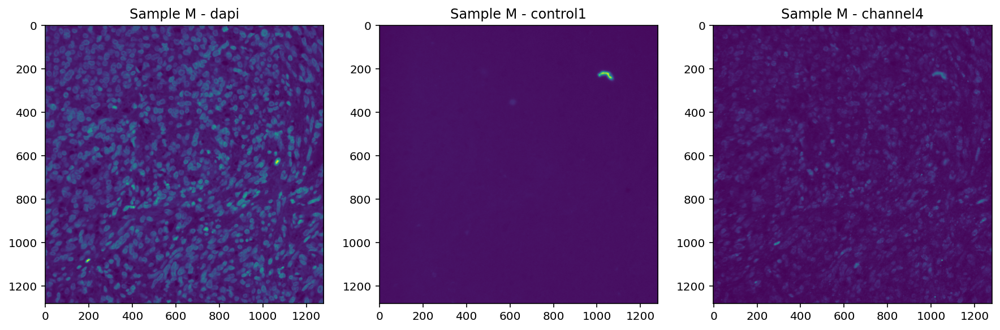

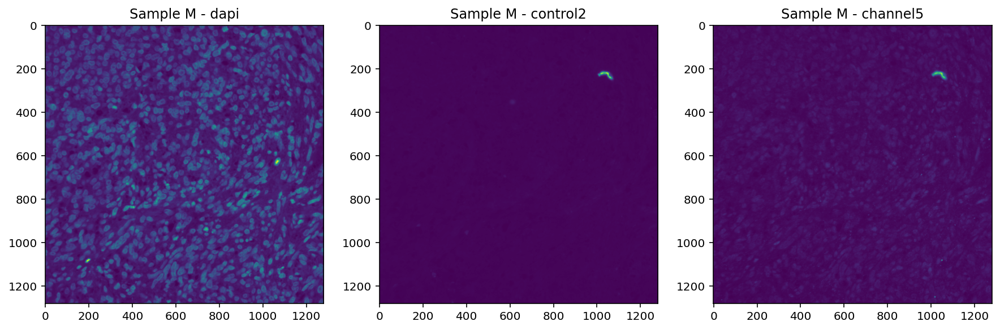

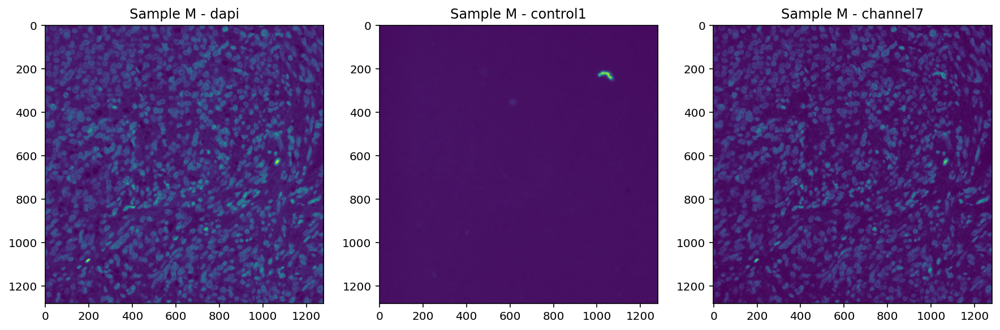

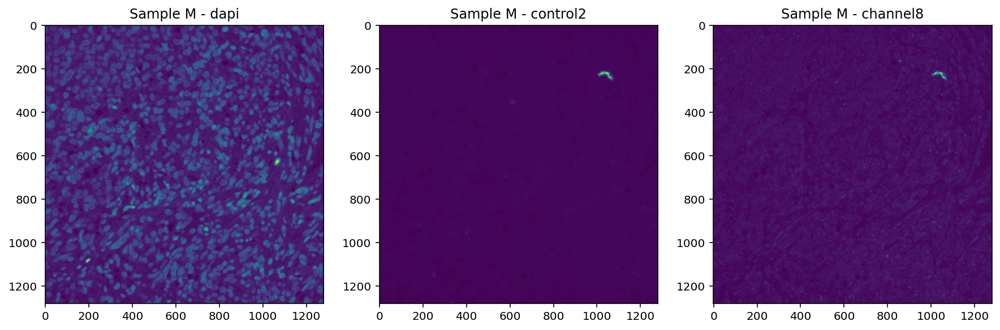

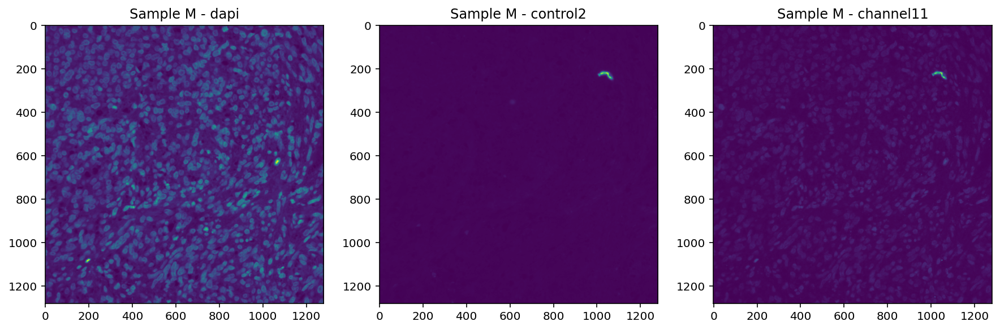

In [128]:
i = 2 #0:extremeless_LLRO, 1:extremeless_LRRO, 2:extremeless_ULRO, 3:extremeless_URRO
patient='M'
#patient OPTIONS:
#          LLRO: ('A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O')  !!Hch11, Ich8&11, Lch5&11, Och5&11
#          LRRO: ('A', 'G', 'J', 'K', 'L', 'M') !!Jch11, Kch5, Lch7, Mch5&8&11
#          ULRO: ('A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N') !!Fch11, Hch5
#          URRO: ('A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N') !!Dchctr2&5&8&11, Gchctr2&5&8&11, Hch8&11, Ich5, Nch11

channels=np.array([4,5,7,8,11])

for ch in channels:
    if (ch - 1) % 3 == 0:
        n_ctrl = 1
    else:
        n_ctrl = 2
        
    fig, ax = plt.subplots(1, 3, figsize=(15,15)) #we create a figure with two subplots (1row, 2columns)
    ax[0].imshow(extremeless_list[i][patient][:,:,0]) #what we plot in the subplot1
    ax[0].set_title('Sample {0} - dapi'.format(patient)) #subplot title
    ax[1].imshow(extremeless_list[i][patient][:,:,n_ctrl]) #what we plot in the subplot1
    ax[1].set_title('Sample {0} - control{1}'.format(patient, n_ctrl)) #subplot title
    ax[2].imshow(extremeless_list[i][patient][:,:,ch])  #what we plot in the subplot2
    ax[2].set_title('Sample {0} - channel{1}'.format(patient, ch)) #subplot title

# IMAGE PRE-PROCESSING

## a) Illumination and background correction

Optical microscopy data, and especially fluorescence imaging, is often severely affected by shading or vignetting, typically reflected as an attenuation of the brightness intensity from the centre of the optical axis to the edges. 

This not only degrades the visual quality of an image, but more critically compromises the downstream analysis of, for example, tissue composition or single-cell properties.

The physical process of image formation can be approximated as a linear function3 that relates a measured image, Imeas(x) at location x, to its uncorrupted true correspondence, Itrue(x), as:

In [23]:
from IPython.display import display, Math, Latex
display(Math(r'I_{measured}  = I_{true}(x) \cdot S(x) + D(x)'))

<IPython.core.display.Math object>

where:
- S(x) represents the change in effective illumination across an image (known as **flat-field**); 
- D(x), known as **dark-field**, is dominated by camera offset and thermal noise, which are present even if no light is incident on the sensor.

Shading correction methods can be generally divided into two groups: 
- __prospective approaches:__ they determine S(x) and D(x) from extra reference images 
- __retrospective approaches:__ which rely on the actual image data itself and hence avoid collection of extra reference images.

In our images, the shading effect is not very strong, howerver, when we recieve the flat-field and dark-field images, we will try to apply this correction implementing the BaSiC algorithim, which uses both S(x) and D(x), not just one, and doesn´t kneed a lot of images to carry out this correction precisely.

## b) Background fluorescence subtraction

If we take a look at the control images for wavelengths 647nm (Ch1) and 565nm (Ch2) we see that, although no staining was jet done on our sample, we still get some fluorescence signal. 

Text(0.5, 1.0, 'G - Channel 11')

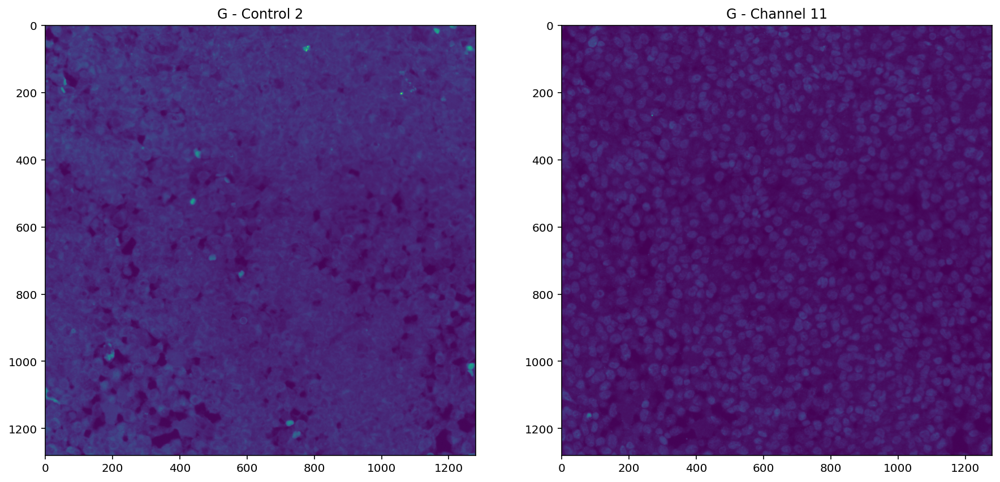

In [121]:
i=0 #0: LLRO, 1: LRRO, 2: ULRO, 3: URRO
sample = 'G'
channel = 11

if (channel - 1) % 3 == 0:
    n_ctrl = 1
else:
    n_ctrl = 2

fig, ax = plt.subplots(1, 2, figsize=(15,15)) #we create a figure with two subplots (1row, 2columns)
ax[0].imshow(extremeless_list[i][sample][:,:,n_ctrl]) #what we plot in the subplot1
ax[0].set_title(sample+' - Control {0}'.format(n_ctrl)) #subplot title
ax[1].imshow(extremeless_list[i][sample][:,:,channel])  #what we plot in the subplot2
ax[1].set_title(sample+' - Channel {0}'.format(channel)) #subplot title

This signal is due to the autofluorescence of biological components in our sample. It doesn´t resent interesting information and could interfere with our Immuno-Saber signal. Therefore, it is convinient that we do some kind of transformation to our images in order to ignore this meaningless fluorescent objects.

Noise from instruments and light sources can be complicated to define and remove, but it tends to remain fairly constant from day to day. Background arising from autofluorescence or from nonspecific staining can be more easily addressed and remedied—at least in theory! 

You should try to reduce this autofluorescence experimentally by choosing the right wavelenth and right staining fluorophores. If after doing so, some autofluorescence still remains, it can be treated by processing the images. 

The approach is simmple: segment this autofluorescent objects for each control and multiply each mask by its origial control image.

Then, simply substract the image resulting from that multiplication to each sample image (dont forget that this substraction to make sense, it must be done to images captured at the same wavelength)

### Segmentation of the autofluorescent objects in the control images

1) Select a threshold for segmentation using an unsupervised algorithm. 

2) Apply this theshold to our control images in order to create our segmentation masks.

3) Multiply our masks to our control images to obtain an image with only the autofluorescent bodies (background=0)

4) Remove autofluorescent bodies by substract the last objects from our images. 
To check how well this method works, lets substract it from our control images to see if after applying this algprithm, we can still detect some autofluorescence.


We have quite succesfully removed the main autofluorescent bodies in our controll images. The remaining signal has some square pattern which is very probable due to the process of tile-imaging and stitching of images.

If we wanted to correct these, we would have to do it in the a)illumination and background correction stage, maybe with the BaSic algorithm.

5) Now we know it works, lets apply this to all our images A-N in our dictionary. 

In a diferent script we created a loop for applying the previously described steps to all of our images. this script is called "AFremoval" and was converted into a function that can be called from this script.

In [103]:
"""from preprocessing_GIST import AFremoval #we import our previously built function

noAF_LLRO = AFremoval(extremeless_LLRO, table_summary=False) #apply the autofluorescence background removal to all of our images.
print('Check1')
noAF_LRRO = AFremoval(extremeless_LRRO, table_summary=False) 
print('Check2')
noAF_ULRO = AFremoval(extremeless_ULRO, table_summary=False) 
print('Check3')
noAF_URRO = AFremoval(extremeless_URRO, table_summary=False) """

Check1
Check2
Check3


This last cell was very time consuming : /
For this reason I will save these dictionaries in a python object so I can proceed with the analysis faster.

In [109]:
"""# load pickle module
import pickle

saving_name = ['./pickles/file_LLRO_noAF.pkl','./pickles/file_LRRO_noAF.pkl','./pickles/file_ULRO_noAF.pkl','file_URRO_noAF.pkl']
noAF_list = [noAF_LLRO, noAF_LRRO, noAF_ULRO, noAF_URRO]

i=0
for c in noAF_list:
    # create a binary pickle file 
    f = open(saving_name[i],"wb")
    # write the python object (dict) to pickle file
    pickle.dump(c,f)
    # close file
    f.close()
    i+=1"""

In [112]:
# load pickle module
import pickle

saving_name = ['./pickles/file_LLRO_noAF.pkl','./pickles/file_LRRO_noAF.pkl','./pickles/file_ULRO_noAF.pkl','./pickles/file_URRO_noAF.pkl']
noAF_list = [noAF_LLRO, noAF_LRRO, noAF_ULRO, noAF_URRO]

i=0
for file in saving_name:
    #We reach for our saved dictionary
    f = open(file, 'rb')
    noAF_list[i] = pickle.load(f)
    f.close()
    i+=1

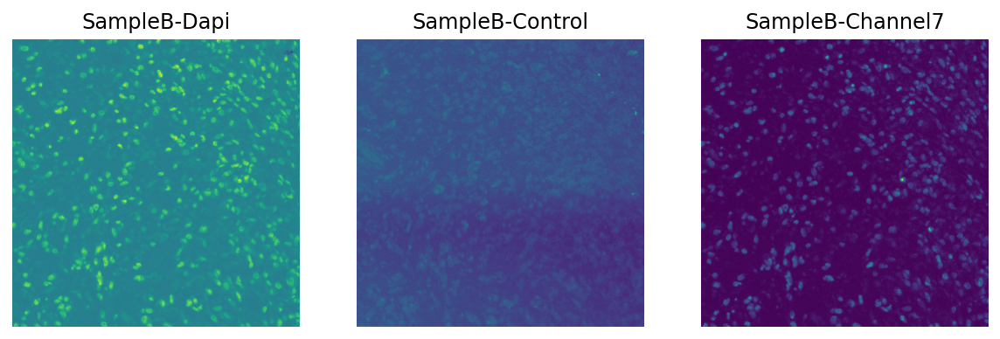

In [114]:
from preprocessing_GIST import img_inspection #we import our previously built function
img_inspection(noAF_list[0], r=1, image='B',channel=7, view=True, table_summary=False, histogram=False)

#IMAGE OPTIONS: random or:
#          0: noAF_LLRO: ('A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O')
#          1: noAF_LRRO: ('A', 'G', 'J', 'K', 'L', 'M')
#          2: noAF_ULRO: ('A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N')
#          3: noAF_URRO: ('A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N')

#CHANNEL OPTIONS: 4,5,7,8,11 or random

#IMAGE DICTIONARY OPTIONS: noAF_LLRO, noAF_LRRO, noAF_ULRO, noAF_URRO
#see function's documentation for more info.

Let´s choose randomly one of the channels of one of the images to see if we can appreciate the improvement.

Text(0.5, 1.0, 'M no AF- Ch4')

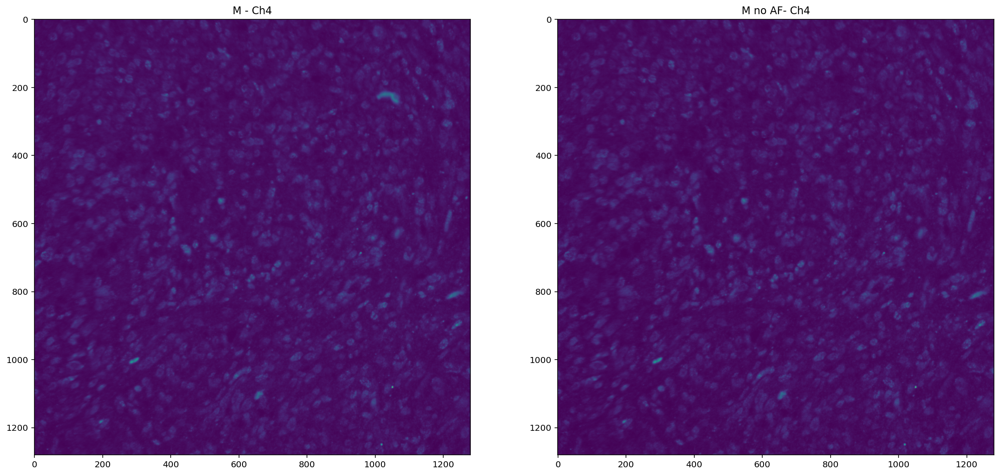

In [129]:
i=2 # 0=LLRO, 1=LRRO, 2=ULRO, 3=URRO
sample = 'M'
channel = 4 #4,5,7,8,11

# SAMPLE OPTIONS:
#      0: LLRO: ('A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O')
#      1: LRRO: ('A', 'G', 'J', 'K', 'L', 'M')
#      2: ULRO: ('A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N')
#      3: URRO: ('A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N')


fig, ax = plt.subplots(1, 2, figsize=(20,20)) #we create a figure with two subplots (1row, 2columns)
ax[0].imshow(extremeless_list[i][sample][:,:,channel]) #what we plot in the subplot1
ax[0].set_title(sample +' - Ch{0}'.format(channel)) #subplot title
ax[1].imshow(noAF_list[i][sample][:,:,channel])  #what we plot in the subplot2
ax[1].set_title(sample+' no AF- Ch{0}'.format(channel)) #subplot title

Visually, we cannot really appreciate the difference, but we may have saved ourselfs from compromising the posterior analysis.

## c) Normalization of our multiplexed images

_ref: Robust normalization protocols for multiplexed fluorescence bioimage analysis_.

Unfortunately, immuno-fluorescence microscopy techniques suffer from variability in intensity of signals from protein markers within a run and across different runs. Therefore, it is necessary to standardize protocols for preprocessing of the multiplexed bioimaging (MBI) data from multiple runs to a comparable scale before any further analysis can be performed on the data.

The aim of the overall pre-processing of the MBI data (i.e. a set of n MBIs obtained for n visual fields per sample) is to align and normalize the data so the signals of one MBI for protein marker A can be compared to the signals in another MBI for protein B. Since the co-location of the signals and signal intensities are of primary concern, the MBIs must be aligned in two domains, the spatial domain (a problem that is usually referred to as the signal registration) and the intensity domain (the problem of signal normalization), so that the signal intensities of any given sub-cellular location or ROIs (regions of interest) can be compared between different data sets.

In our case, I believe efforts to guarantee optimal colocalization of images have already been done (ASHLAR), so we will focuse in this section on the intensity alignment.

1. **CLIPPING:** We'll use the truncate filter to eliminate the outlier values, we truncate the highest and lowest values per intensity image.

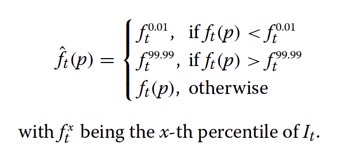

In [130]:
from IPython.display import Image
display(Image(filename = 'truncate.jpeg'))

In [131]:
"""import copy

#We create a copy of our image directory:
LLRO_clip=copy.deepcopy(noAF_LLRO)
ULRO_clip=copy.deepcopy(noAF_ULRO)
LRRO_clip=copy.deepcopy(noAF_LRRO)
URRO_clip=copy.deepcopy(noAF_URRO)

clip_list = [LLRO_clip, LRRO_clip, ULRO_clip, URRO_clip]

ex_sample = 'A' #ej, es ist egal.
rows = LLRO_clip[ex_sample].shape[0] #number of rows
cols = LLRO_clip[ex_sample].shape[1] #number of columns
channels = LLRO_clip[ex_sample].shape[2] #number of channels

for c in clip_list:
    for im in c:
        for ch in range(channels):
            p99 = np.percentile(c[im][:,:,ch],99.99)
            p1 = np.percentile(c[im][:,:,ch],0.01)
            for i in range(rows):
                for j in range(cols):
                    if c[im][i,j,ch] > p99:
                        c[im][i,j,ch] = p99
                    elif c[im][i,j,ch] < p1:
                        c[im][i,j,ch] = p1"""

This last cell was very time consuming : /

For this reason I will save this dictionary in a python object so I can proceed with the analysis faster.

In [132]:
"""# load pickle module
import pickle

saving_name = ['./pickles/file_LLRO_clip.pkl','./pickles/file_LRRO_clip.pkl','./pickles/file_ULRO_clip.pkl','./pickles/file_URRO_clip.pkl']
clip_list = [LLRO_clip, LRRO_clip, ULRO_clip, URRO_clip]

i=0
for c in clip_list:
    # create a binary pickle file 
    f = open(saving_name[i],"wb")
    # write the python object (dict) to pickle file
    pickle.dump(c,f)
    # close file
    f.close()
    i+=1"""

In [7]:
# load pickle module
import pickle

saving_name = ['./pickles/file_LLRO_clip.pkl','./pickles/file_LRRO_clip.pkl','./pickles/file_ULRO_clip.pkl','./pickles/file_URRO_clip.pkl']

LLRO_clip = {}
LRRO_clip = {}
ULRO_clip = {}
URRO_clip = {}

clip_list = [LLRO_clip, LRRO_clip, ULRO_clip, URRO_clip]

i=0
for file in saving_name:
    #We reach for our saved dictionary
    f = open(file, 'rb')
    clip_list[i] = pickle.load(f)
    f.close()
    i+=1

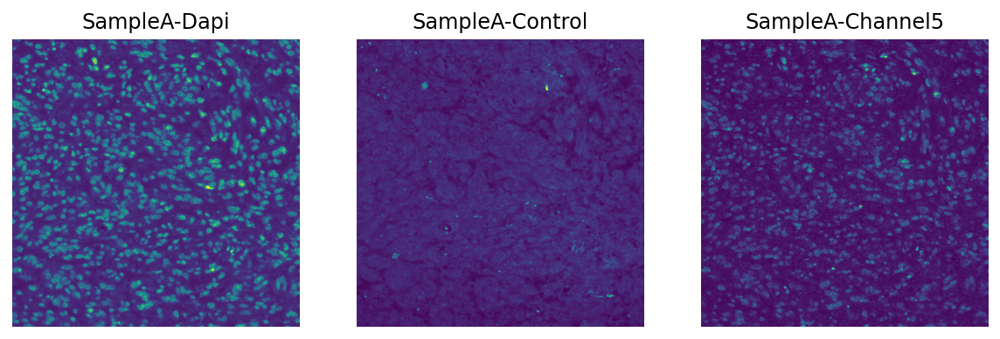

In [136]:
from preprocessing_GIST import img_inspection #we import our previously built function
img_inspection(clip_list[0], r=1, image='A', view=True, table_summary=False, histogram=False)

# SAMPLE OPTIONS:
#      0: LLRO: ('A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O')
#      1: LRRO: ('A', 'G', 'J', 'K', 'L', 'M')
#      2: ULRO: ('A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N')
#      3: URRO: ('A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N')

#CHANNEL OPTIONS: 4,5,7,8,11 or random

2. **Denoising:**


_Noise in Images_

Noise in images, is any degradation in an image signal, caused by external disturbance while an image is being sent from one place to another place via satellite, wireless and network cable.

Types of Image Noise:
* Salt and pepper noise: It known as shot noise, impulse noise or Spike noise. Its appearance is randomly scattered white or black or both pixel over the image.
* Gaussian Noise: Gaussian noise is caused by random fluctuations in the signal; it’s modelled by random values added to an image. This noise has a probability density function of the normal distribution. It is also known as Gaussian distribution.
* Speckle noise: It can be modelled by random values multiplied by pixel values of an image.

In our image set I believe there is not much noise, and definitely, it is not salt and pepper or speckle. We will deal with denoising methods for gaussian noise.

Mathematically there are two basic models of Noise; additive and multiplicative. Additive noise is systematic in nature and can be easily modelled and hence removed or reduced easily. Whereas multiplicative noise is image dependent, complex to model and hence difficult to reduce. When multiplicative noise caused by the de-phased echoes from the scattering appears, it is called Speckle Noise. Although it appears as noise but it contains useful information because it is due to surroundings of the target. Speckle may appear distinct in different imaging systems but it is always manifested in a granular pattern due to image formation under coherent waves.


The **median filter** is a popular non-linear filter conventionally used in fluorescence microscopy images. It replaces the intensity value of the center pixel with the median of intensity values of a neighborhood window of the size Mm × Mm. The median filter has excellent noise-reduction capabilities with good edge preservation particularly in the presence of bipolar and unipolar impulse noise.

_To learn more about the basic principle of median filter refer to Ref: A COMPARATIVE STUDY OF DIFFERENT NOISE FILTERING TECHNIQUES IN DIGITAL IMAGES_

In [137]:
"""from skimage.filters import median
from skimage.morphology import disk

import copy

#We create a copy of our image directory:
LLRO_denoised = copy.deepcopy(clip_list[0])
LRRO_denoised = copy.deepcopy(clip_list[1])
ULRO_denoised = copy.deepcopy(clip_list[2])
URRO_denoised = copy.deepcopy(clip_list[3])

denoised_list = [LLRO_denoised, LRRO_denoised, ULRO_denoised, URRO_denoised]

ex_sample = 'A' #eg, es ist egal.
rows = LLRO_denoised[ex_sample].shape[0] #number of rows
cols = LLRO_denoised[ex_sample].shape[1] #number of columns
channels = LLRO_denoised[ex_sample].shape[2] #number of channels

for d in denoised_list:
    for im in d:
        for ch in range(channels):
            d[im][:,:,ch] = median(d[im][:,:,ch],disk(3))"""

In [138]:
"""# load pickle module
import pickle

saving_name = ['./pickles/file_LLRO_denoised.pkl','./pickles/file_LRRO_denoised.pkl','./pickles/file_ULRO_denoised.pkl','./pickles/file_URRO_denoised.pkl']
denoised_list = [LLRO_denoised, LRRO_denoised, ULRO_denoised, URRO_denoised]

i=0
for c in denoised_list:
    # create a binary pickle file 
    f = open(saving_name[i],"wb")
    # write the python object (dict) to pickle file
    pickle.dump(c,f)
    # close file
    f.close()
    i+=1"""

In [2]:
# load pickle module
import pickle

saving_name = ['./pickles/file_LLRO_denoised.pkl','./pickles/file_LRRO_denoised.pkl','./pickles/file_ULRO_denoised.pkl','./pickles/file_URRO_denoised.pkl']

LLRO_denoised = {}
LRRO_denoised = {}
ULRO_denoised = {}
URRO_denoised = {}

denoised_list = [LLRO_denoised, LRRO_denoised, ULRO_denoised, URRO_denoised]

i=0
for file in saving_name:
    #We reach for our saved dictionary
    f = open(file, 'rb')
    denoised_list[i] = pickle.load(f)
    f.close()
    i+=1

Lest quickly compare one of our images before and after denoising:

Text(0.5, 1.0, 'M denoised - Channel 4')

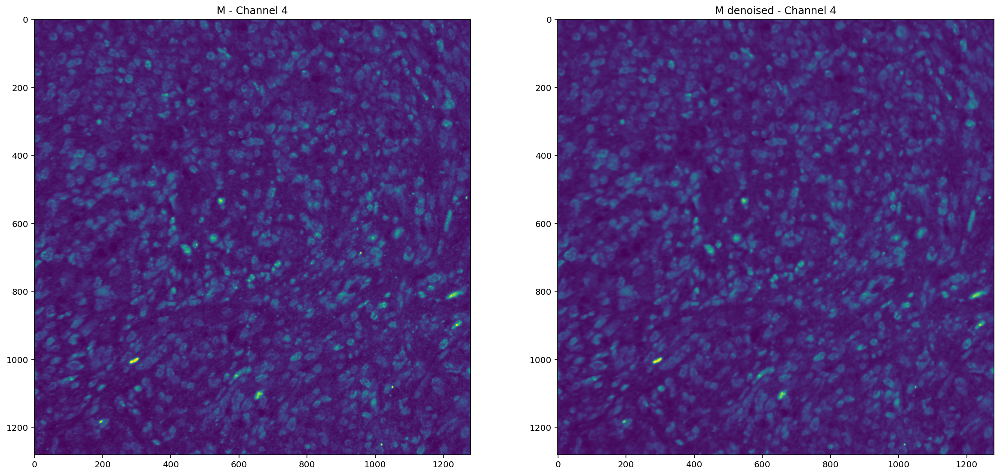

In [8]:
i=2 # 0=LLRO, 1=LRRO, 2=ULRO, 3=URRO
sample = 'M'
channel = 4 #4,5,7,8,11

fig, ax = plt.subplots(1, 2, figsize=(20,20)) #we create a figure with two subplots (1row, 2columns)
ax[0].imshow(clip_list[i][sample][:,:,channel]) #what we plot in the subplot1
ax[0].set_title(sample + ' - Channel {0}'.format(channel)) #subplot title
ax[1].imshow(denoised_list[i][sample][:,:,channel])  #what we plot in the subplot2
ax[1].set_title(sample + ' denoised - Channel {0}'.format(channel)) #subplot title

# SAMPLE OPTIONS:
#      0: LLRO: ('A', 'B', 'C', 'G', 'H', 'I', 'L', 'M', 'N', 'O')
#      1: LRRO: ('A', 'G', 'J', 'K', 'L', 'M')
#      2: ULRO: ('A', 'B', 'C', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N')
#      3: URRO: ('A', 'B', 'C', 'D', 'G', 'H', 'I', 'J', 'M', 'N')

#CHANNEL OPTIONS: 4,5,7,8,11 or random

The image didnt have much noise, therefore, the denoising filter chosen was not very strong. There is no big difference between both images (pre and post denoising)

3. **Renormalization:** 

The strong binding of a protein marker in a particular region may produce high intensity values in that region, rendering the weaker regions almost completely unidentified for analysis purposes due to their relatively weaker intensity. 

**LINEAR NORMALIZATION**
Linear renormalization can be applied to ensure that the dynamic range of each image in the MBI stack is the same.

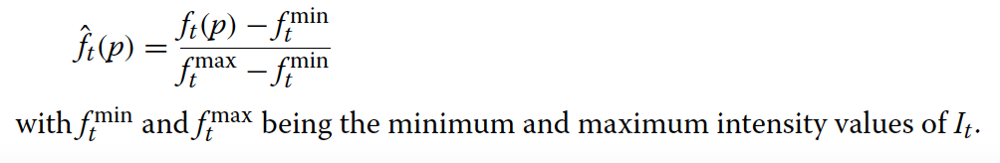

In [141]:
from IPython.display import Image
display(Image(filename = 'linear-normalization.png'))

In [10]:
"""import copy

#We create a copy of our image directory:
LLRO_norm =copy.deepcopy(denoised_list[0])
LRRO_norm =copy.deepcopy(denoised_list[1])
ULRO_norm =copy.deepcopy(denoised_list[2])
URRO_norm =copy.deepcopy(denoised_list[3])

norm_list = [LLRO_norm, LRRO_norm, ULRO_norm, URRO_norm]

ex_sample = 'A' #eg, es ist egal.
rows = LLRO_norm[ex_sample].shape[0] #number of rows
cols = LLRO_norm[ex_sample].shape[1] #number of columns
channels = LLRO_norm[ex_sample].shape[2] #number of channels

for n in norm_list:
    for im in n:
        for ch in range(channels):
            minimum = np.min(n[im][:,:,ch])
            maximum = np.max(n[im][:,:,ch])
            denom = maximum - minimum
            if denom==0:
                print('oh, oh, something went wrong and mean=0, check values')
                break
            for i in range(rows):
                for j in range(cols):
                    n[im][i,j,ch] = (n[im][i,j,ch]-minimum)/denom"""

In [11]:
"""#load pickle module
import pickle

saving_name = ['./pickles/file_LLRO_norm.pkl','./pickles/file_LRRO_norm.pkl','./pickles/file_ULRO_norm.pkl','./pickles/file_URRO_norm.pkl']
norm_list = [LLRO_norm, LRRO_norm, ULRO_norm, URRO_norm]

i=0
for n in norm_list:
    # create a binary pickle file 
    f = open(saving_name[i],"wb")
    # write the python object (dict) to pickle file
    pickle.dump(n,f)
    # close file
    f.close()
    i+=1"""

In [12]:
# load pickle module
import pickle

saving_name = ['./pickles/file_LLRO_norm.pkl','./pickles/file_LRRO_norm.pkl','./pickles/file_ULRO_norm.pkl','./pickles/file_URRO_norm.pkl']

LLRO_norm = {}
LRRO_norm = {}
ULRO_norm = {}
URRO_norm = {}

norm_list = [LLRO_norm, LRRO_norm, ULRO_norm, URRO_norm]

i=0
for file in saving_name:
    #We reach for our saved dictionary
    f = open(file, 'rb')
    norm_list[i] = pickle.load(f)
    f.close()
    i+=1

Text(0.5, 1.0, 'M normalized- Ch4: 565nm')

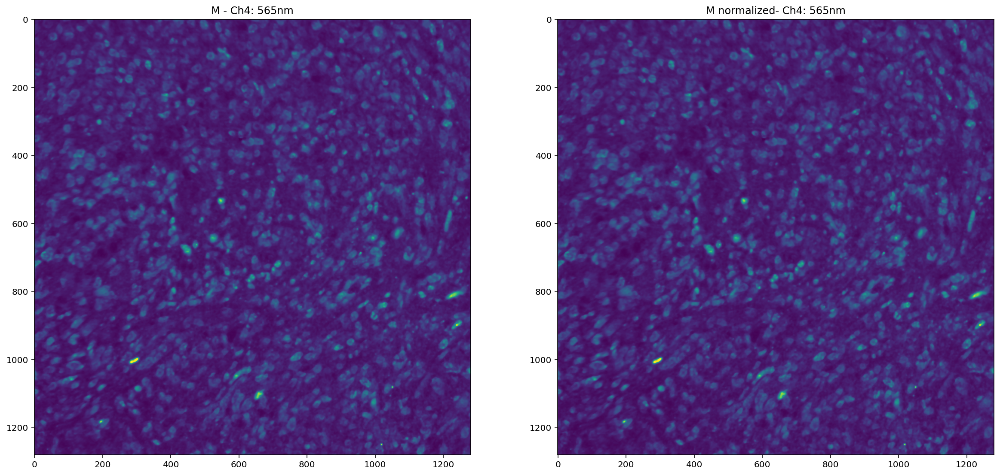

In [13]:
i=2 # 0=LLRO, 1=LRRO, 2=ULRO, 3=URRO
sample = 'M'
channel = 4 #4,5,7,8,11

ch = 0
fig, ax = plt.subplots(1, 2, figsize=(20,20)) #we create a figure with two subplots (1row, 2columns)
ax[0].imshow(denoised_list[i][sample][:,:,channel]) #what we plot in the subplot1
ax[0].set_title(sample + ' - Ch{0}: 565nm'.format(channel)) #subplot title
ax[1].imshow(norm_list[i][sample][:,:,channel])  #what we plot in the subplot2
ax[1].set_title(sample + ' normalized- Ch{0}: 565nm'.format(channel)) #subplot title

# SAVE OUR PREPROCESSED IMAGES
Ideally we would like to segment our images through a deep learning method. However, current methods require prelabelled data or a very appropiate preexisting pretrained method. We havent found the second, and therefore we will label a few images in fiji.

We will need to save our preprocessed images in a .tif format in a shape that fiji will understand (channels first)

In [17]:
import copy

#We create a copy of our image directory:
LLRO_preprocessed =copy.deepcopy(denoised_list[0])
LRRO_preprocessed =copy.deepcopy(denoised_list[1])
ULRO_preprocessed =copy.deepcopy(denoised_list[2])
URRO_preprocessed =copy.deepcopy(denoised_list[3])

preprocessed_list = [LLRO_preprocessed, LRRO_preprocessed, ULRO_preprocessed, URRO_preprocessed]

In [18]:
i=2 # 0=LLRO, 1=LRRO, 2=ULRO, 3=URRO
sample = 'M'

print(np.shape(preprocessed_list[i])) #dictionary
print(np.shape(preprocessed_list[i][sample])) #hipermatrix of 12 channels

()
(1280, 1280, 12)


In [19]:
for p in preprocessed_list:
    for im in p: #loop across every object (image) in the dictionary.
        p[im] = np.moveaxis(p[im], 2, 0) #reestructuring of image matrix

In [20]:
print(np.shape(preprocessed_list[i]['A'])) #hipermatrix of 12 channels

(12, 1280, 1280)


In [23]:
from tifffile import imsave

for im in preprocessed_list[0]:
        imsave('./preprocessed/20210621-GIST-TMA-SBR-LLR0-A01-pp'+ im + '.tif', preprocessed_list[0][im])
for im in preprocessed_list[1]:
        imsave('./preprocessed/20210621-GIST-TMA-SBR-LRRO-A01-pp'+ im + '.tif', preprocessed_list[1][im])
for im in preprocessed_list[2]:
        imsave('./preprocessed/20210621-GIST-TMA-SBR-ULRO-A01-pp'+ im + '.tif', preprocessed_list[2][im])
for im in preprocessed_list[3]:
        imsave('./preprocessed/20210621-GIST-TMA-SBR-URR0-A01-pp'+ im + '.tif', preprocessed_list[3][im])